<a href="https://colab.research.google.com/github/Peckkie/DPDM2021/blob/main/2_Merging_table_2_Data_Source.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive # เชื่อม google drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
os.chdir( '/content/drive/MyDrive/DPDM_ME/my_project/data') # local path
!pwd

/content/drive/MyDrive/DPDM_ME/my_project/data


In [3]:
!ls

 Countries_ranked_by_life_expectancy.csv
 covid_19_clean_complete.csv
 covid_19_data.csv
 data_after_clean.csv
 data_berfore_clean.csv
 DataFromWeb
 Net_Change.csv
'time_series_covid19_confirmed_global (1).csv'
 time_series_covid19_confirmed_global.csv
'time_series_covid19_deaths_global (1).csv'
 time_series_covid19_deaths_global.csv
'time_series_covid19_recovered_global (1).csv'
 time_series_covid19_recovered_global.csv
 time_series_covid19_worldometer.csv
 worldometer_covid.csv
 worldometer.csv


# Open Data

In [4]:
import pandas as pd

In [5]:
worldometer = pd.read_csv('worldometer_covid.csv')
print(worldometer.shape)
worldometer.head()

(217, 16)


,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region
0,USA,North America,3.334160e+08,44214497,15001.0,714098.0,145.0,33637480.0,2778.0,9862919.0,20918.0,132611.0,2142.0,639992884.0,1919502.0,Americas
1,India,Asia,1.396865e+09,33765470,27282.0,448372.0,282.0,33034902.0,27617.0,282196.0,8944.0,24172.0,321.0,568956439.0,407310.0,South-EastAsia
2,Brazil,South America,2.144378e+08,21399546,NaN,596163.0,NaN,20404701.0,NaN,398682.0,8318.0,99794.0,2780.0,57282520.0,267129.0,Americas
3,UK,Europe,6.832944e+07,7807036,36480.0,136662.0,137.0,6323896.0,31662.0,1346478.0,813.0,114256.0,2000.0,303448502.0,4440963.0,Europe
4,Russia,Europe,1.460123e+08,7511026,23888.0,207255.0,867.0,6672767.0,18826.0,631004.0,2300.0,51441.0,1419.0,191500000.0,1311533.0,Europe


In [6]:
covid = pd.read_csv('covid_19_clean_complete.csv')
print(covid.shape)
covid.head()

(168575, 10)


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa


# Checking key column

In [7]:
len(set(worldometer['Country/Region']))

217

In [8]:
len(set(covid['Country/Region']))

194

In [9]:
set(worldometer['Country/Region']) - set(covid['Country/Region'])

{'Anguilla',
 'Aruba',
 'Bermuda',
 'British Virgin Islands',
 'Brunei ',
 'CAR',
 'Caribbean Netherlands',
 'Cayman Islands',
 'Channel Islands',
 'Congo',
 'Curaçao',
 'DRC',
 'Diamond Princess',
 'Faeroe Islands',
 'Falkland Islands',
 'French Guiana',
 'French Polynesia',
 'Gibraltar',
 'Guadeloupe',
 'Hong Kong',
 'Isle of Man',
 'Ivory Coast',
 'MS Zaandam',
 'Macao',
 'Martinique',
 'Mayotte',
 'Montserrat',
 'Myanmar',
 'New Caledonia',
 'Palestine',
 'Réunion',
 'S. Korea',
 'Saint Martin',
 'Saint Pierre Miquelon',
 'Sint Maarten',
 'St. Barth',
 'St. Vincent Grenadines',
 'Taiwan',
 'Turks and Caicos',
 'UAE',
 'UK',
 'USA',
 'Vatican City',
 'Wallis and Futuna',
 'Western Sahara'}

In [10]:
set(covid['Country/Region']) - set(worldometer['Country/Region'])

{'Brunei',
 'Burma',
 'Central African Republic',
 'China',
 'Congo (Brazzaville)',
 'Congo (Kinshasa)',
 "Cote d'Ivoire",
 'Holy See',
 'Kiribati',
 'Kosovo',
 'Marshall Islands',
 'Micronesia',
 'Saint Vincent and the Grenadines',
 'Samoa',
 'South Korea',
 'Summer Olympics 2020',
 'Taiwan*',
 'US',
 'United Arab Emirates',
 'United Kingdom',
 'Vanuatu',
 'West Bank and Gaza'}

### fixing Country names

In [11]:
# fixing Country names
# ===========================================================

In [12]:
worldometer['Country/Region'] = worldometer['Country/Region'].replace('UK', 'United Kingdom')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('USA', 'US')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('S. Korea', 'South Korea')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('Brunei ', 'Brunei')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('UAE', 'United Arab Emirates')
covid['Country/Region'] = covid['Country/Region'].replace('Taiwan*', 'Taiwan')

## Merging  

In [13]:
# table = pd.merge(left=covid, right=worldometer, how='left', on=['Country/Region'])

In [14]:
covid['Population'] = covid['Country/Region'].map(worldometer.set_index('Country/Region')['Population']) #เชื่อมเอา คอลัมน์ Population
covid['Continent'] = covid['Country/Region'].map(worldometer.set_index('Country/Region')['Continent'])#เชื่อมเอา คอลัมน์ Continent
covid

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Population,Continent
0,NaN,Afghanistan,33.939110,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,40015559.0,Asia
1,NaN,Albania,41.153300,20.168300,2020-01-22,0,0,0,0,Europe,2873887.0,Europe
2,NaN,Algeria,28.033900,1.659600,2020-01-22,0,0,0,0,Africa,44833764.0,Africa
3,NaN,Andorra,42.506300,1.521800,2020-01-22,0,0,0,0,Europe,77419.0,Europe
4,NaN,Angola,-11.202700,17.873900,2020-01-22,0,0,0,0,Africa,34132209.0,Africa
...,...,...,...,...,...,...,...,...,...,...,...,...
168570,NaN,Vietnam,14.058324,108.277199,2021-09-25,746678,18400,0,728278,Western Pacific,98427082.0,Asia
168571,NaN,West Bank and Gaza,31.952200,35.233200,2021-09-25,395677,4018,0,391659,Eastern Mediterranean,NaN,NaN
168572,NaN,Yemen,15.552727,48.516388,2021-09-25,8891,1682,0,7209,Eastern Mediterranean,30640654.0,Asia
168573,NaN,Zambia,-13.133897,27.849332,2021-09-25,208829,3645,0,205184,Africa,19021822.0,Africa


In [15]:
# save as .csv file
covid.to_csv('time_series_covid19_worldometer.csv', index=False)

# Visualization

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go 
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
import plotly.express as px
%matplotlib inline

In [17]:
from datetime import datetime #packet ที่ใช้ในการจัดการ ข้อมูลประเภท datetime
covid['Date'] = pd.to_datetime(covid['Date'], yearfirst=True)

In [18]:
px.line(covid,
       x='Date',
       y='Confirmed',
       template='plotly_dark',
       title='Daily trends of Covid-19 cases',
        labels={'Date':'Month','value':'Statistics'})

In [19]:
px.line(covid,
       x='Date',
       y='Active',
       template='plotly_dark',
       title='Daily trends of Covid-19 cases',
        labels={'Date':'Month','value':'Statistics'})

In [20]:
px.line(covid,
       x='Date',
       y='Deaths',
       template='plotly_dark',
       title='Daily trends of Covid-19 cases',
        labels={'Date':'Month','value':'Statistics'})

In [21]:
px.line(covid,
       x='Date',
       y='Recovered',
       template='plotly_dark',
       title='Daily trends of Covid-19 cases',
        labels={'Date':'Month','value':'Statistics'})

In [22]:
covid[covid['Date'] >= '2021-08-05']

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Population,Continent
154275,NaN,Afghanistan,33.939110,67.709953,2021-08-05,149361,6864,0,142497,Eastern Mediterranean,40015559.0,Asia
154276,NaN,Albania,41.153300,20.168300,2021-08-05,133442,2457,0,130985,Europe,2873887.0,Europe
154277,NaN,Algeria,28.033900,1.659600,2021-08-05,178013,4441,0,173572,Africa,44833764.0,Africa
154278,NaN,Andorra,42.506300,1.521800,2021-08-05,14809,128,0,14681,Europe,77419.0,Europe
154279,NaN,Angola,-11.202700,17.873900,2021-08-05,43269,1032,0,42237,Africa,34132209.0,Africa
...,...,...,...,...,...,...,...,...,...,...,...,...
168570,NaN,Vietnam,14.058324,108.277199,2021-09-25,746678,18400,0,728278,Western Pacific,98427082.0,Asia
168571,NaN,West Bank and Gaza,31.952200,35.233200,2021-09-25,395677,4018,0,391659,Eastern Mediterranean,NaN,NaN
168572,NaN,Yemen,15.552727,48.516388,2021-09-25,8891,1682,0,7209,Eastern Mediterranean,30640654.0,Asia
168573,NaN,Zambia,-13.133897,27.849332,2021-09-25,208829,3645,0,205184,Africa,19021822.0,Africa


In [23]:
covid_ = covid[covid['Date'] <= '2021-08-04']

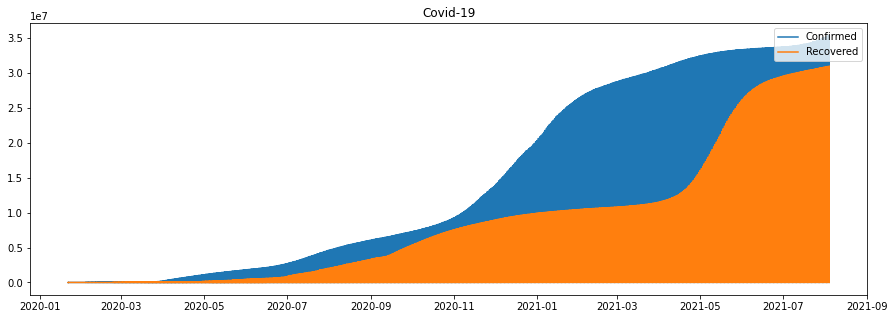

In [24]:
fig = plt.figure(figsize=(15,5))
ax = plt.axes()

x = covid_['Date']
y = covid_['Confirmed']
y2 = covid_['Recovered']
plt.plot(x, y)
plt.plot(x, y2)
ax.set(title='Covid-19');
plt.legend(['Confirmed', 'Recovered'], loc=1)


In [25]:
covid.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Population,Continent
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,40015559.0,Asia
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,2873887.0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,44833764.0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,77419.0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,34132209.0,Africa


In [26]:
covid.isnull().any()

Province/State     True
Country/Region    False
Lat                True
Long               True
Date              False
Confirmed         False
Deaths            False
Recovered         False
Active            False
WHO Region         True
Population         True
Continent          True
dtype: bool

In [27]:
covid_2 = covid.dropna(subset=['WHO Region'])
covid_2.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Population,Continent
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,40015559.0,Asia
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,2873887.0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,44833764.0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,77419.0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,34132209.0,Africa


In [28]:
fig3 = px.bar(covid_2, x = 'WHO Region', y = 'Confirmed',color = 'WHO Region') #template = "plotly_dark"
fig3

# Questions

## 1 เเสดง ประเทศที่มีประชากรมากที่สุดเเละมีอัตราส่วนการเป็นโควิดเเล้วหายเท่าไหร่

In [29]:
full_grouped= covid
full_grouped.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Population,Continent
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,40015559.0,Asia
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,2873887.0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,44833764.0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,77419.0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,34132209.0,Africa


In [30]:
country_wise = full_grouped.groupby('Country/Region')['Confirmed', 'Deaths', 
                                                      'Recovered', 'Active'].sum().reset_index()
print(country_wise.shape)

(194, 5)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



### เชื่อมตาราง 

In [31]:
country_wise.head(5)

,Country/Region,Confirmed,Deaths,Recovered,Active
0,Afghanistan,32827056,1368795,18289880,13168381
1,Albania,36324322,671028,22652652,13000642
2,Algeria,47497032,1359675,25670233,20467124
3,Andorra,4104350,47352,3085649,971349
4,Angola,9871637,240875,5895800,3734962


In [37]:
# !ls

In [41]:
worldometer = pd.read_csv('/content/drive/MyDrive/DPDM_ME/my_project/data/worldometer_covid.csv')

In [42]:
worldometer['Country/Region'] = worldometer['Country/Region'].replace('UK', 'United Kingdom')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('USA', 'US')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('S. Korea', 'South Korea')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('Brunei ', 'Brunei')
worldometer['Country/Region'] = worldometer['Country/Region'].replace('UAE', 'United Arab Emirates')
country_wise['Country/Region'] = country_wise['Country/Region'].replace('Taiwan*', 'Taiwan')

In [43]:
worldometer

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region
0,US,North America,3.334160e+08,44214497,15001.0,714098.0,145.0,33637480.0,2778.0,9862919.0,20918.0,132611.0,2142.0,639992884.0,1919502.0,Americas
1,India,Asia,1.396865e+09,33765470,27282.0,448372.0,282.0,33034902.0,27617.0,282196.0,8944.0,24172.0,321.0,568956439.0,407310.0,South-EastAsia
2,Brazil,South America,2.144378e+08,21399546,NaN,596163.0,NaN,20404701.0,NaN,398682.0,8318.0,99794.0,2780.0,57282520.0,267129.0,Americas
3,United Kingdom,Europe,6.832944e+07,7807036,36480.0,136662.0,137.0,6323896.0,31662.0,1346478.0,813.0,114256.0,2000.0,303448502.0,4440963.0,Europe
4,Russia,Europe,1.460123e+08,7511026,23888.0,207255.0,867.0,6672767.0,18826.0,631004.0,2300.0,51441.0,1419.0,191500000.0,1311533.0,Europe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212,Vatican City,Europe,8.030000e+02,27,NaN,NaN,NaN,27.0,NaN,0.0,NaN,33624.0,NaN,NaN,NaN,Europe
213,Solomon Islands,Australia/Oceania,7.077650e+05,20,NaN,NaN,NaN,20.0,NaN,0.0,NaN,28.0,NaN,4500.0,6358.0,WesternPacific
214,Western Sahara,Africa,6.155450e+05,10,NaN,1.0,NaN,8.0,NaN,1.0,NaN,16.0,2.0,NaN,NaN,Africa
215,MS Zaandam,NaN,NaN,9,NaN,2.0,NaN,7.0,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN


In [44]:
country_wise['Population'] = country_wise['Country/Region'].map(worldometer.set_index('Country/Region')['Population']) #เชื่อมเอา คอลัมน์ Population
country_wise['Continent'] = country_wise['Country/Region'].map(worldometer.set_index('Country/Region')['Continent'])#เชื่อมเอา คอลัมน์ Continent
country_wise

,Country/Region,Confirmed,Deaths,Recovered,Active,Population,Continent
0,Afghanistan,32827056,1368795,18289880,13168381,40015559.0,Asia
1,Albania,36324322,671028,22652652,13000642,2873887.0,Europe
2,Algeria,47497032,1359675,25670233,20467124,44833764.0,Africa
3,Andorra,4104350,47352,3085649,971349,77419.0,Europe
4,Angola,9871637,240875,5895800,3734962,34132209.0,Africa
...,...,...,...,...,...,...,...
189,Vietnam,27423804,600172,1261448,25562184,98427082.0,Asia
190,West Bank and Gaza,80911294,873170,57608773,22429351,NaN,NaN
191,Yemen,1836912,406490,772497,657925,30640654.0,Asia
192,Zambia,34371860,547270,21852796,11971794,19021822.0,Africa


### เช็ค missing values

In [45]:
country_wise.isnull().any()

Country/Region    False
Confirmed         False
Deaths            False
Recovered         False
Active            False
Population         True
Continent          True
dtype: bool

In [46]:
country_wise[['Population']] = country_wise[['Population']].fillna(country_wise[['Population']].dropna().mode().iloc[0,0]) 

In [47]:
country_wise.isnull().any()

Country/Region    False
Confirmed         False
Deaths            False
Recovered         False
Active            False
Population        False
Continent          True
dtype: bool

### เรียงลำดับเพื่อหา top 25 ของปรเทศที่มีประชากรเยอที่สุด

In [50]:
country_wise25 = country_wise.sort_values(by=['Population'], ascending = False)[0:25]
country_wise25

,Country/Region,Confirmed,Deaths,Recovered,Active,Population,Continent
79,India,6964801239,93589286,4859387857,2011824096,1.396865e+09,Asia
180,US,10371113601,197582351,496971828,9676559422,3.334160e+08,North America
80,Indonesia,636535548,18859283,363942501,253733764,2.771175e+08,Asia
131,Pakistan,290903980,6373547,206507371,78023062,2.262142e+08,Asia
23,Brazil,4971288241,137379849,3412350387,1421558005,2.144378e+08,South America
127,Nigeria,54672019,758584,39492087,14421348,2.124730e+08,Africa
13,Bangladesh,303842374,4756846,190856309,108229219,1.667283e+08,Asia
142,Russia,1656204145,36823800,1128064202,491316143,1.460123e+08,Europe
113,Mexico,805759418,72135195,498203576,235420647,1.306160e+08,North America
87,Japan,218019131,3398271,129683074,84937786,1.259946e+08,Asia


### หาอัตราส่วนการเป็นโควิดเเล้วหาย


In [51]:
country_wise25['Recovered_ratio'] = country_wise25['Recovered']/country_wise25['Confirmed']
country_wise25

,Country/Region,Confirmed,Deaths,Recovered,Active,Population,Continent,Recovered_ratio
79,India,6964801239,93589286,4859387857,2011824096,1.396865e+09,Asia,0.697707
180,US,10371113601,197582351,496971828,9676559422,3.334160e+08,North America,0.047919
80,Indonesia,636535548,18859283,363942501,253733764,2.771175e+08,Asia,0.571755
131,Pakistan,290903980,6373547,206507371,78023062,2.262142e+08,Asia,0.709882
23,Brazil,4971288241,137379849,3412350387,1421558005,2.144378e+08,South America,0.686412
127,Nigeria,54672019,758584,39492087,14421348,2.124730e+08,Africa,0.722346
13,Bangladesh,303842374,4756846,190856309,108229219,1.667283e+08,Asia,0.628143
142,Russia,1656204145,36823800,1128064202,491316143,1.460123e+08,Europe,0.681114
113,Mexico,805759418,72135195,498203576,235420647,1.306160e+08,North America,0.618303
87,Japan,218019131,3398271,129683074,84937786,1.259946e+08,Asia,0.594824


### Visualization

In [52]:
data = dict(type='choropleth',
            locations = country_wise25['Country/Region'],
            locationmode = 'country names',
            z = country_wise25['Recovered_ratio'],
            text = country_wise25['Country/Region'],
            colorbar = {'title':'Recovered_ratio'}
            ) 

layout = dict(title='Covid Cases (Recovered_ratio)',
             geo=dict(showframe=False,
                     projection={'type':'natural earth'}))

choromap1=go.Figure(data=[data],layout=layout)
iplot(choromap1)

In [53]:
# Country wise
# ===========================================================

full_grouped['Date'] = pd.to_datetime(full_grouped['Date'])

# getting latest values
country_wise = full_grouped[full_grouped['Date']==max(full_grouped['Date'])] \
                    .reset_index(drop=True) \
                    .drop('Date', axis=1)

print(country_wise.shape)

(275, 11)


In [54]:
# group by country
country_wise = country_wise.groupby('Country/Region')['Confirmed', 'Deaths', 
                                                      'Recovered', 'Active'].sum().reset_index()
print(country_wise.shape)

(194, 5)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [55]:
# per 100 cases
country_wise['Deaths / 100 Cases'] = round((country_wise['Deaths']/country_wise['Confirmed'])*100, 2)
country_wise['Recovered / 100 Cases'] = round((country_wise['Recovered']/country_wise['Confirmed'])*100, 2)
country_wise['Deaths / 100 Recovered'] = round((country_wise['Deaths']/country_wise['Recovered'])*100, 2)

In [56]:
cols = ['Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered']
country_wise[cols] = country_wise[cols].fillna(0)

In [57]:
from datetime import datetime, timedelta 

In [58]:
# 1 week increase and % change
# ===========================================================

today = full_grouped[full_grouped['Date']==max(full_grouped['Date'])] \
            .reset_index(drop=True) \
            .drop('Date', axis=1)[['Country/Region', 'Confirmed']]

last_week = full_grouped[full_grouped['Date']==max(full_grouped['Date'])-timedelta(days=7)] \
                .reset_index(drop=True) \
                .drop('Date', axis=1)[['Country/Region', 'Confirmed']]

temp = pd.merge(today, last_week, on='Country/Region', suffixes=(' today', ' last week'))
temp['1 week change'] = temp['Confirmed today'] - temp['Confirmed last week']
temp = temp[['Country/Region', 'Confirmed last week', '1 week change']]
country_wise = pd.merge(country_wise, temp, on='Country/Region')
country_wise

,Country/Region,Confirmed,Deaths,Recovered,Active,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Confirmed last week,1 week change
0,Afghanistan,154960,7199,0,147761,4.65,0.0,inf,154487,473
1,Albania,167354,2629,0,164725,1.57,0.0,inf,162173,5181
2,Algeria,202574,5767,0,196807,2.85,0.0,inf,201425,1149
3,Andorra,15167,130,0,15037,0.86,0.0,inf,15124,43
4,Angola,54795,1487,0,53308,2.71,0.0,inf,52307,2488
...,...,...,...,...,...,...,...,...,...,...
1918,Vietnam,746678,18400,0,728278,2.46,0.0,inf,677023,69655
1919,West Bank and Gaza,395677,4018,0,391659,1.02,0.0,inf,382584,13093
1920,Yemen,8891,1682,0,7209,18.92,0.0,inf,8630,261
1921,Zambia,208829,3645,0,205184,1.75,0.0,inf,208422,407


In [59]:
country_wise['1 week % increase'] = round(country_wise['1 week change']/country_wise['Confirmed last week']*100, 2)
country_wise.head()


,Country/Region,Confirmed,Deaths,Recovered,Active,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Confirmed last week,1 week change,1 week % increase
0,Afghanistan,154960,7199,0,147761,4.65,0.0,inf,154487,473,0.31
1,Albania,167354,2629,0,164725,1.57,0.0,inf,162173,5181,3.19
2,Algeria,202574,5767,0,196807,2.85,0.0,inf,201425,1149,0.57
3,Andorra,15167,130,0,15037,0.86,0.0,inf,15124,43,0.28
4,Angola,54795,1487,0,53308,2.71,0.0,inf,52307,2488,4.76


In [60]:
who_region = {}

# African Region AFRO
afro = "Algeria, Angola, Cabo Verde, Eswatini, Sao Tome and Principe, Benin, South Sudan, Western Sahara, Congo (Brazzaville), Congo (Kinshasa), Cote d'Ivoire, Botswana, Burkina Faso, Burundi, Cameroon, Cape Verde, Central African Republic, Chad, Comoros, Ivory Coast, Democratic Republic of the Congo, Equatorial Guinea, Eritrea, Ethiopia, Gabon, Gambia, Ghana, Guinea, Guinea-Bissau, Kenya, Lesotho, Liberia, Madagascar, Malawi, Mali, Mauritania, Mauritius, Mozambique, Namibia, Niger, Nigeria, Republic of the Congo, Rwanda, São Tomé and Príncipe, Senegal, Seychelles, Sierra Leone, Somalia, South Africa, Swaziland, Togo, Uganda, Tanzania, Zambia, Zimbabwe"
afro = [i.strip() for i in afro.split(',')]
for i in afro:
    who_region[i] = 'Africa'
    
# Region of the Americas PAHO
paho = 'Antigua and Barbuda, Argentina, Bahamas, Barbados, Belize, Bolivia, Brazil, Canada, Chile, Colombia, Costa Rica, Cuba, Dominica, Dominican Republic, Ecuador, El Salvador, Grenada, Guatemala, Guyana, Haiti, Honduras, Jamaica, Mexico, Nicaragua, Panama, Paraguay, Peru, Saint Kitts and Nevis, Saint Lucia, Saint Vincent and the Grenadines, Suriname, Trinidad and Tobago, United States, US, Uruguay, Venezuela'
paho = [i.strip() for i in paho.split(',')]
for i in paho:
    who_region[i] = 'Americas'

# South-East Asia Region SEARO
searo = 'Bangladesh, Bhutan, North Korea, India, Indonesia, Maldives, Myanmar, Burma, Nepal, Sri Lanka, Thailand, Timor-Leste'
searo = [i.strip() for i in searo.split(',')]
for i in searo:
    who_region[i] = 'South-East Asia'

# European Region EURO
euro = 'Albania, Andorra, Greenland, Kosovo, Holy See, Liechtenstein, Armenia, Czechia, Austria, Azerbaijan, Belarus, Belgium, Bosnia and Herzegovina, Bulgaria, Croatia, Cyprus, Czech Republic, Denmark, Estonia, Finland, France, Georgia, Germany, Greece, Hungary, Iceland, Ireland, Israel, Italy, Kazakhstan, Kyrgyzstan, Latvia, Lithuania, Luxembourg, Malta, Monaco, Montenegro, Netherlands, North Macedonia, Norway, Poland, Portugal, Moldova, Romania, Russia, San Marino, Serbia, Slovakia, Slovenia, Spain, Sweden, Switzerland, Tajikistan, Turkey, Turkmenistan, Ukraine, United Kingdom, Uzbekistan'
euro = [i.strip() for i in euro.split(',')]
for i in euro:
    who_region[i] = 'Europe'

# Eastern Mediterranean Region EMRO
emro = 'Afghanistan, Bahrain, Djibouti, Egypt, Iran, Iraq, Jordan, Kuwait, Lebanon, Libya, Morocco, Oman, Pakistan, Palestine, West Bank and Gaza, Qatar, Saudi Arabia, Somalia, Sudan, Syria, Tunisia, United Arab Emirates, Yemen'
emro = [i.strip() for i in emro.split(',')]
for i in emro:
    who_region[i] = 'Eastern Mediterranean'

# Western Pacific Region WPRO
wpro = 'Australia, Brunei, Cambodia, China, Cook Islands, Fiji, Japan, Kiribati, Laos, Malaysia, Marshall Islands, Micronesia, Mongolia, Nauru, New Zealand, Niue, Palau, Papua New Guinea, Philippines, South Korea, Samoa, Singapore, Solomon Islands, Taiwan, Taiwan*, Tonga, Tuvalu, Vanuatu, Vietnam'
wpro = [i.strip() for i in wpro.split(',')]
for i in wpro:
    who_region[i] = 'Western Pacific'

In [61]:
country_wise['WHO Region'] = country_wise['Country/Region'].map(who_region)
country_wise[country_wise['WHO Region'].isna()]['Country/Region'].unique()

country_wise.head()

,Country/Region,Confirmed,Deaths,Recovered,Active,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Confirmed last week,1 week change,1 week % increase,WHO Region
0,Afghanistan,154960,7199,0,147761,4.65,0.0,inf,154487,473,0.31,Eastern Mediterranean
1,Albania,167354,2629,0,164725,1.57,0.0,inf,162173,5181,3.19,Europe
2,Algeria,202574,5767,0,196807,2.85,0.0,inf,201425,1149,0.57,Africa
3,Andorra,15167,130,0,15037,0.86,0.0,inf,15124,43,0.28,Europe
4,Angola,54795,1487,0,53308,2.71,0.0,inf,52307,2488,4.76,Africa


In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go 
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
import plotly.express as px
%matplotlib inline

In [63]:
data = dict(type='choropleth',
            locations = country_wise['Country/Region'],
            locationmode = 'country names',
            z = country_wise['Confirmed'],
            text = country_wise['Country/Region'],
            colorbar = {'title':'Confirmed Cases'}
            ) 

layout = dict(title='Covid Cases (CONFIRMED)',
             geo=dict(showframe=False,
                     projection={'type':'natural earth'}))

choromap1=go.Figure(data=[data],layout=layout)
iplot(choromap1)

##2 แสดงสัดส่วนคนที่ติดโควิดเเล้วเสียชัวิตมากที่สุด 5 ประเทศเเรกในทวีปยุโรปและเอเชีย



### เปิดตาราง worldometer_data

In [64]:
worldometer = pd.read_csv('worldometer_covid.csv')

In [65]:
worldometer.head(5)

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region
0,USA,North America,3.334160e+08,44214497,15001.0,714098.0,145.0,33637480.0,2778.0,9862919.0,20918.0,132611.0,2142.0,639992884.0,1919502.0,Americas
1,India,Asia,1.396865e+09,33765470,27282.0,448372.0,282.0,33034902.0,27617.0,282196.0,8944.0,24172.0,321.0,568956439.0,407310.0,South-EastAsia
2,Brazil,South America,2.144378e+08,21399546,NaN,596163.0,NaN,20404701.0,NaN,398682.0,8318.0,99794.0,2780.0,57282520.0,267129.0,Americas
3,UK,Europe,6.832944e+07,7807036,36480.0,136662.0,137.0,6323896.0,31662.0,1346478.0,813.0,114256.0,2000.0,303448502.0,4440963.0,Europe
4,Russia,Europe,1.460123e+08,7511026,23888.0,207255.0,867.0,6672767.0,18826.0,631004.0,2300.0,51441.0,1419.0,191500000.0,1311533.0,Europe


### เช็ค missing values

In [66]:
worldometer.isnull().any()

Country/Region      False
Continent            True
Population           True
TotalCases          False
NewCases             True
TotalDeaths          True
NewDeaths            True
TotalRecovered       True
NewRecovered         True
ActiveCases          True
Serious,Critical     True
Tot Cases/1M pop     True
Deaths/1M pop        True
TotalTests           True
Tests/1M pop         True
WHO Region           True
dtype: bool

In [67]:
worldometer[['TotalDeaths']] = worldometer[['TotalDeaths']].fillna(worldometer[['TotalDeaths']].dropna().mode().iloc[0,0]) 

In [68]:
worldometer.isnull().any()

Country/Region      False
Continent            True
Population           True
TotalCases          False
NewCases             True
TotalDeaths         False
NewDeaths            True
TotalRecovered       True
NewRecovered         True
ActiveCases          True
Serious,Critical     True
Tot Cases/1M pop     True
Deaths/1M pop        True
TotalTests           True
Tests/1M pop         True
WHO Region           True
dtype: bool

### เช็คประเภทข้อมูล

In [69]:
worldometer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 217 entries, 0 to 216
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Country/Region    217 non-null    object 
 1   Continent         215 non-null    object 
 2   Population        215 non-null    float64
 3   TotalCases        217 non-null    int64  
 4   NewCases          91 non-null     float64
 5   TotalDeaths       217 non-null    float64
 6   NewDeaths         75 non-null     float64
 7   TotalRecovered    216 non-null    float64
 8   NewRecovered      83 non-null     float64
 9   ActiveCases       216 non-null    float64
 10  Serious,Critical  153 non-null    float64
 11  Tot Cases/1M pop  215 non-null    float64
 12  Deaths/1M pop     208 non-null    float64
 13  TotalTests        209 non-null    float64
 14  Tests/1M pop      209 non-null    float64
 15  WHO Region        186 non-null    object 
dtypes: float64(12), int64(1), object(3)
memory u

In [70]:
# convert to int datatype
worldometer['TotalDeaths'] = worldometer['TotalDeaths'].astype('int')

### สร้างคอลัมน์ใหม่ ชื่อว่า Deaths_ratio

In [71]:
worldometer['Deaths_ratio']  = (worldometer['TotalDeaths'] /worldometer['TotalCases'])*100

### หา top 5 ของสัดส่วนคนที่เป็นโควิดเเล้วเสียชีวิตของทวีปยุโรปและเอเชีย

In [72]:
europe = worldometer[worldometer['Continent'] == 'Europe'].sort_values(by=['Deaths_ratio'], ascending = False)[0:5]
europe

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,Deaths_ratio
85,Bosnia and Herzegovina,Europe,3255412.0,234775,1000.0,10606,32.0,192218.0,NaN,31951.0,NaN,72118.0,3258.0,1227043.0,376924.0,Europe,4.517517
56,Bulgaria,Europe,6883316.0,500112,NaN,20812,NaN,435780.0,NaN,43520.0,458.0,72656.0,3024.0,4786244.0,695340.0,Europe,4.161468
212,Vatican City,Europe,803.0,27,NaN,1,NaN,27.0,NaN,0.0,NaN,33624.0,NaN,NaN,NaN,Europe,3.703704
41,Hungary,Europe,9629822.0,822705,633.0,30190,5.0,785090.0,551.0,7425.0,87.0,85433.0,3135.0,6932779.0,719928.0,Europe,3.669602
89,North Macedonia,Europe,2083268.0,191408,494.0,6668,12.0,172653.0,474.0,12087.0,NaN,91879.0,3201.0,1289516.0,618987.0,Europe,3.483658


In [73]:
asia = worldometer[worldometer['Continent'] == 'Asia'].sort_values(by=['Deaths_ratio'], ascending = False)[0:5]
asia

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,Deaths_ratio
170,Yemen,Asia,30640654.0,9067,28.0,1721,6.0,5634.0,17.0,1712.0,23.0,296.0,56.0,265253.0,8657.0,EasternMediterranean,18.980920
134,Syria,Asia,18027704.0,33933,NaN,2238,NaN,23742.0,NaN,7953.0,NaN,1882.0,124.0,103566.0,5745.0,EasternMediterranean,6.595350
152,Taiwan,Asia,23870400.0,16223,7.0,842,NaN,15227.0,7.0,154.0,NaN,680.0,35.0,6339853.0,265595.0,WesternPacific,5.190162
97,Afghanistan,Asia,40015559.0,155191,17.0,7206,2.0,124733.0,102.0,23252.0,1124.0,3878.0,180.0,760532.0,19006.0,EasternMediterranean,4.643311
60,Myanmar,Asia,54863277.0,462608,NaN,17682,NaN,416927.0,NaN,27999.0,NaN,8432.0,322.0,4299547.0,78368.0,South-EastAsia,3.822243


### Visualization

In [74]:
Deaths_ration_eu = europe['Deaths_ratio'].tolist()
Deaths_ration_asia = asia['Deaths_ratio'].tolist()

In [75]:
fig1=px.bar(europe,
      x='Country/Region',
      y=Deaths_ration_eu,
      template='plotly_dark',
      color='Country/Region',
      title='สัดส่วนคนที่ติดโควิดเเล้วเสียชัวิตมากที่สุด 5 ประเทศเเรกในทวีปยุโรป',
      labels={'y':'Deaths Ratio'},
      text=Deaths_ration_eu,
      color_discrete_sequence=['#1D2533','#242838','#2B2B3C','#322E41','#3A3145','#423349','#4B364C','#53384F','#5C3B52','#653D54','#6E3F55','#764257','#7F4457','#874758','#904A57','#984D57','#9F5056','#A65455','#AD5853','#B35D51'
])
fig1.update_traces(texttemplate='%{text:0.1fs%}', textposition='outside')
fig1.update_xaxes(tickangle=270)
fig1.show()

In [76]:
fig1=px.bar(asia,
      x='Country/Region',
      y=Deaths_ration_asia,
      template='plotly_dark',
      color='Country/Region',
      title='สัดส่วนคนที่ติดโควิดเเล้วเสียชัวิตมากที่สุด 5 ประเทศเเรกในทวีปเอเชีย',
      labels={'y':'Deaths Ratio'},
      text=Deaths_ration_asia,
      color_discrete_sequence=['#1D2533','#242838','#2B2B3C','#322E41','#3A3145','#423349','#4B364C','#53384F','#5C3B52','#653D54','#6E3F55','#764257','#7F4457','#874758','#904A57','#984D57','#9F5056','#A65455','#AD5853','#B35D51'
])
fig1.update_traces(texttemplate='%{text:0.1fs%}', textposition='outside')
fig1.update_xaxes(tickangle=270)
fig1.show()

## New

In [77]:
country_wise

,Country/Region,Confirmed,Deaths,Recovered,Active,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Confirmed last week,1 week change,1 week % increase,WHO Region
0,Afghanistan,154960,7199,0,147761,4.65,0.0,inf,154487,473,0.31,Eastern Mediterranean
1,Albania,167354,2629,0,164725,1.57,0.0,inf,162173,5181,3.19,Europe
2,Algeria,202574,5767,0,196807,2.85,0.0,inf,201425,1149,0.57,Africa
3,Andorra,15167,130,0,15037,0.86,0.0,inf,15124,43,0.28,Europe
4,Angola,54795,1487,0,53308,2.71,0.0,inf,52307,2488,4.76,Africa
...,...,...,...,...,...,...,...,...,...,...,...,...
1918,Vietnam,746678,18400,0,728278,2.46,0.0,inf,677023,69655,10.29,Western Pacific
1919,West Bank and Gaza,395677,4018,0,391659,1.02,0.0,inf,382584,13093,3.42,Eastern Mediterranean
1920,Yemen,8891,1682,0,7209,18.92,0.0,inf,8630,261,3.02,Eastern Mediterranean
1921,Zambia,208829,3645,0,205184,1.75,0.0,inf,208422,407,0.20,Africa


In [78]:
country_wise.isnull().any()

Country/Region            False
Confirmed                 False
Deaths                    False
Recovered                 False
Active                    False
Deaths / 100 Cases        False
Recovered / 100 Cases     False
Deaths / 100 Recovered    False
Confirmed last week       False
1 week change             False
1 week % increase          True
WHO Region                 True
dtype: bool

In [79]:
country_wise['Deaths_ratio']  = (country_wise['Deaths'] /country_wise['Confirmed'])*100
country_wise.head()

,Country/Region,Confirmed,Deaths,Recovered,Active,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Confirmed last week,1 week change,1 week % increase,WHO Region,Deaths_ratio
0,Afghanistan,154960,7199,0,147761,4.65,0.0,inf,154487,473,0.31,Eastern Mediterranean,4.645715
1,Albania,167354,2629,0,164725,1.57,0.0,inf,162173,5181,3.19,Europe,1.570922
2,Algeria,202574,5767,0,196807,2.85,0.0,inf,201425,1149,0.57,Africa,2.846861
3,Andorra,15167,130,0,15037,0.86,0.0,inf,15124,43,0.28,Europe,0.857124
4,Angola,54795,1487,0,53308,2.71,0.0,inf,52307,2488,4.76,Africa,2.713751


In [80]:
# europe = country_wise[country_wise['Continent'] == 'Europe'].sort_values(by=['Deaths_ratio'], ascending = False)[0:5]
# europe

In [81]:
Deaths_ration_eu = europe['Deaths_ratio'].tolist()

fig1=px.bar(europe,
      x='Country/Region',
      y=Deaths_ration_eu,
      template='plotly_dark',
      color='Country/Region',
      title='สัดส่วนคนที่ติดโควิดเเล้วเสียชัวิตมากที่สุด 5 ประเทศเเรกในทวีปยุโรป',
      labels={'y':'Deaths Ratio'},
      text=Deaths_ration_eu,
      color_discrete_sequence=['#1D2533','#242838','#2B2B3C','#322E41','#3A3145','#423349','#4B364C','#53384F','#5C3B52','#653D54','#6E3F55','#764257','#7F4457','#874758','#904A57','#984D57','#9F5056','#A65455','#AD5853','#B35D51'
])
fig1.update_traces(texttemplate='%{text:0.1fs%}', textposition='outside')
fig1.update_xaxes(tickangle=270)
fig1.show()